<a href="https://colab.research.google.com/github/22ananya/MUSI6201/blob/main/Final%20Project%20-%20Stereo%20Demixing/start.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Import Dependencies

In [ ]:
import numpy as np
import scipy.io.wavfile as wav
import librosa
import matplotlib.pyplot as plt
!pip install pyclarity==0.4.0 # install the package provided by the challenge organizers

Import pytorch and check version

In [ ]:
import torch
print(torch.__version__)

2.1.0+cu118


Connect to Google Drive

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

Load the training data from drive and play a sample

In [ ]:
import os
print(os.getcwd())

/content


Improve code below to read a random file instead of providing the exact path to one file

In [8]:
fs, x = wav.read('/content/drive/MyDrive/Cadenza_Challenge/cad_icassp_2024/audio/at_mic_music/train/A Classic Education - NightOwl-hlp_0003/mixture.wav')
from IPython.display import Audio
print(np.shape(x))
Audio(x[:,0], rate=fs)

(7560512, 2)


Create a wrapper function that loads all the channels for a given audio file.


In [9]:
audiopath = '/content/drive/MyDrive/Cadenza_Challenge/cad_icassp_2024/audio/at_mic_music/train/A Classic Education - NightOwl-hlp_0003/'

audio_files = [] # initialize list of audio files
for file in os.listdir(audiopath): # iterate over all files in the directory
    if file.endswith('.wav'): # if the file is an audio file
        audio_files.append(os.path.join(audiopath, file)) # add the file to the list of audio files

audio_data = [] # initialize list of audio data
N = len(audio_files)
# loop over audio files
for i in range(N): # iterate over all audio files
    print('Reading file ' + str(i+1) + ' of ' + str(len(audio_files)) + '...') # print progress
    fs, x = wav.read(audio_files[i]) # load audio file
    audio_data.append(np.swapaxes(x,0,1)) # save audio in numpy array

audio_data = np.array(audio_data).astype(float)
print(np.shape(audio_data))
print("Sampling Rate is: " + str(fs))


Reading file 1 of 5...
Reading file 2 of 5...
Reading file 3 of 5...
Reading file 4 of 5...
Reading file 5 of 5...
(5, 2, 7560512)
Sampling Rate is: 44100


Plot the waveform of the mix, as well as the sources


In [10]:
Audio(audio_data[3,1,:], rate=fs)

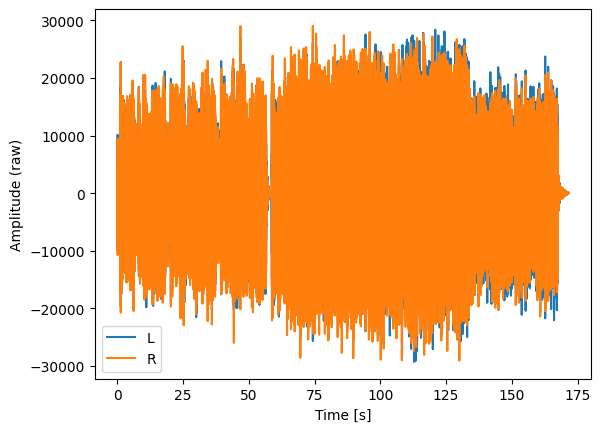

In [11]:
# create time vector
t = np.arange(0,(np.shape(audio_data)[2])/fs, 1/fs)
fig, ax = plt.subplots()
l1 = ax.plot(t, audio_data[0,0,:], label = "L")
l2 = ax.plot(t, audio_data[0,1,:], label = "R")
ax.set_xlabel('Time [s]')
ax.set_ylabel('Amplitude (raw)')
ax.legend()
plt.show()

Create sample spectrograms - Need to fix sample rate issue - librosa is 22kHz

[0.00000000e+00 2.15332031e+01 4.30664062e+01 ... 2.20069336e+04
 2.20284668e+04 2.20500000e+04]
[4076176  519443  294817 ... 1082678 1165555   49862]


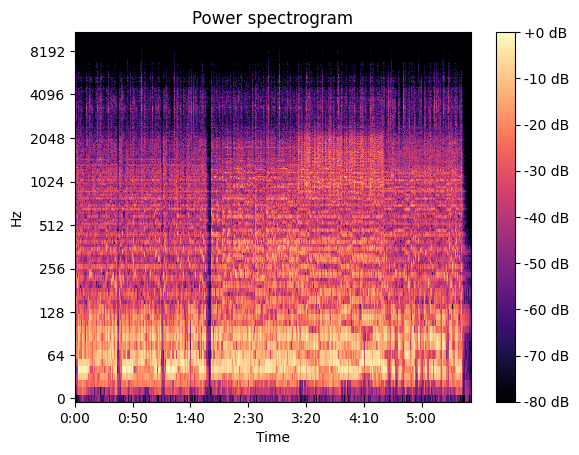

In [12]:
stftl = librosa.stft(audio_data[0,:,:], n_fft=2048, hop_length=512, win_length=2048, window='hann')
fig, ax = plt.subplots()
img = librosa.display.specshow(librosa.amplitude_to_db(np.abs(stftl[0,:,:]), ref=np.max), y_axis='log', x_axis='time', ax=ax)
stft_amp = np.abs(stftl)
stft_ang = np.angle(stftl)
#img = ax.imshow(librosa.amplitude_to_db(np.abs(stft[0,:,:]), ref=np.max))
ax.set_title('Power spectrogram')
fig.colorbar(img, ax=ax, format="%+2.0f dB")



f = librosa.fft_frequencies(sr=fs, n_fft=2048)
print(f)
t = librosa.frames_to_samples(stft_amp[0,0,:], hop_length=512, n_fft=2048)
print(t)

In [13]:
print(stftl.shape)

(2, 1025, 14767)


(2, 1025, 4924)


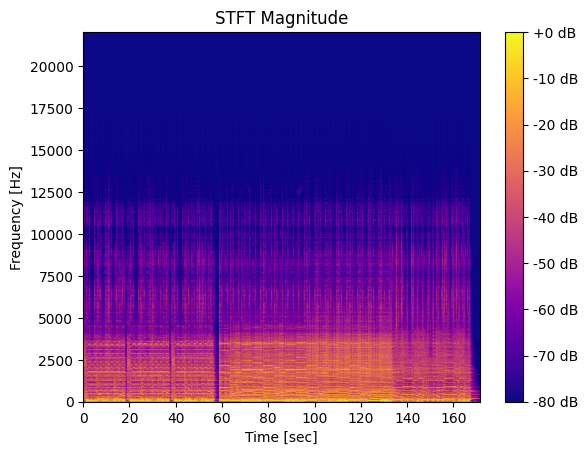

In [14]:
# using scipy spectrogram to maintain sampling rate
from scipy.signal import stft, istft
f, t, X = stft(audio_data[0,:,:],fs = fs,nperseg=2048, noverlap=512)
# convert to log scale
X = librosa.amplitude_to_db(np.abs(X), ref=np.max)

print(X.shape)
fig, ax = plt.subplots()
img = plt.pcolormesh(t, f, X[1,:,:], cmap = 'plasma', shading='gouraud')
ax.set_title('Power spectrogram')
fig.colorbar(img, ax=ax, format="%+2.0f dB")
ax.set_title('STFT Magnitude')
ax.set_ylabel('Frequency [Hz]')
ax.set_xlabel('Time [sec]')
plt.show()

time, audio = istft(X, fs, nperseg=2048, noverlap=512)

Building a basic Pytorch model

In [15]:
from torch import nn
to_numpy = lambda x: x.detach().numpy()
to_tensor = lambda x: torch.from_numpy(x).reshape(-1, 1).float()

class Model(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, data):
        return data

Check what device is being used

In [16]:
device = (
    "cuda"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)
print(f"Using {device} device")

Using cpu device


Visualize the different audio sources

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


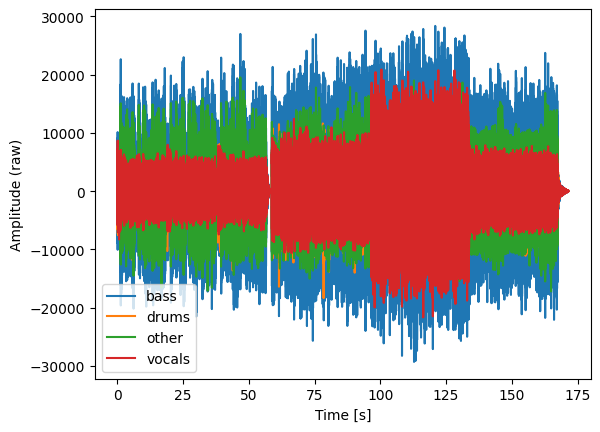

In [33]:
# create time vector
t = np.arange(0,(np.shape(audio_data)[2])/fs, 1/fs)
fig, ax = plt.subplots()
mask = [0,1,3,4]
l1 = ax.plot(t[:], np.swapaxes(audio_data[mask,0,:], 0,1), label = ["bass", "drums","other", "vocals"])
#l2 = ax.plot(t, audio_data[0,1,:], label = "R")
ax.set_xlabel('Time [s]')
ax.set_ylabel('Amplitude (raw)')
ax.legend()
plt.show()

Manually build a mask for just the vocals

[1 1 0 1 1]
